In [1]:
from pydap.client import open_url
from datetime import datetime
import numpy as np
import pandas as pd
import time
from datetime import timedelta
import pyproj
import xarray as xr
from scipy.interpolate import LinearNDInterpolator
import matplotlib.pyplot as plt
import math
import pickle
from datetime import date
import os
import plotly.express as px
import cartopy.crs as ccrs
from cartopy.mpl.ticker import LongitudeFormatter, LatitudeFormatter
import matplotlib
import cartopy as cart


def retrieve_microplastics_gt():
    lats = np.zeros(181)
    count = 90
    for i in range(len(lats)):
        lats[i] = count
        count -= 1
    for filename in os.listdir('../microplast_gt'):
        logfilename = filename[:-4] + '_log'
        try:
            df = pd.read_csv('../microplast_gt/' + filename, header=None)

        except:
            print(filename)
            continue
        longlist = []
        latlist = []
        valuelist_log = []
        valuelist = []
        for long in range(0, 361):
            for lat in range(0, 181):
                val = df[long][lat]
                if val < 1:
                    val = np.nan
                longlist.append(long)
                latlist.append(lats[lat])
                valuelist_log.append(np.log10(val))
                valuelist.append(val)
        if filename == "lebretonmodel_abundance.csv":
            res_df = pd.DataFrame(
                {'sp_lon': longlist, 'sp_lat': latlist, filename[:-4]: valuelist, logfilename: valuelist_log})
        else:
            res_df[filename[:-4]] = valuelist
            res_df[logfilename] = valuelist_log
    return res_df


def plot_wind(df, var1, var2, interpolated=False):
    # Settings for the plot
    ax = plt.axes(projection=ccrs.PlateCarree())
    ax.coastlines()
    lon_formatter = LongitudeFormatter()
    lat_formatter = LatitudeFormatter()
    ax.xaxis.set_major_formatter(lon_formatter)
    ax.yaxis.set_major_formatter(lat_formatter)
    ax.gridlines(draw_labels=True, alpha=0.5)
    plt.scatter(df['sp_lon'], df['sp_lat'], c=list(np.sqrt(df[var1] ** 2 + df[var2] ** 2)), cmap='RdBu')
    bar = plt.colorbar(pad=0.15, orientation='horizontal')
    bar.ax.set_title('m/s')
    plt.xlabel('Longitude')
    plt.ylabel('Latitude')
    if interpolated:
        plt.savefig('wind_speed_inter.png')
    else:
        plt.savefig('wind_speed.png')
    plt.show()


def plot_var(df, var):
    # Settings for the plot
    ax = plt.axes(projection=ccrs.PlateCarree())
    ax.coastlines()
    ax.add_feature(cart.feature.LAND, zorder=100, edgecolor='k')
    ax.gridlines(draw_labels=True, alpha=0.5)
    lon_formatter = LongitudeFormatter(zero_direction_label=True)
    lat_formatter = LatitudeFormatter()
    ax.xaxis.set_major_formatter(lon_formatter)
    ax.yaxis.set_major_formatter(lat_formatter)
    plt.scatter(df['sp_lon'], df['sp_lat'], c=list(df[var]))
    bar = plt.colorbar(pad=0.15, orientation='horizontal')
    plt.title(var)
    bar.ax.set_title('Power 10^')
    plt.xlabel('Longitude')
    plt.ylabel('Latitude')
    plt.savefig('nbrcs-diff.svg')
    plt.show()

# SET AREA, Function Is called when extracting CYGNSS, OSKAR and ERA5
def reduce_area_of_df(df):
    df = df[df.sp_lat <= 40]
    df = df[df.sp_lat >= -40]

    df_northern = df[df.sp_lat >= 20]
    df_southern = df[df.sp_lat <= -20]
    df = pd.concat([df_northern, df_southern])
    df = df[df.sp_lon >= 220]
    return df[df.sp_lon <= 260]


# SET AREA, Function Is called when extracting CYGNSS, OSKAR and ERA5
def reduce_area_of_df(df):
    df = df[df.sp_lat <= 40]
    df = df[df.sp_lat >= -40]

    df_northern = df[df.sp_lat >= 20]
    df_southern = df[df.sp_lat <= -20]
    df = pd.concat([df_northern, df_southern])
    df = df[df.sp_lon >= 220]
    return df[df.sp_lon <= 260]

def open_anomalies_csvs():
    df_list = []
    for filename in os.listdir('../mss_ano_df2'):
        df_list.append(pd.read_csv('../mss_ano_df2/' + filename))
    if len(df_list) == 1:
        return df_list[0]
    else:
        return pd.concat(df_list)

In [2]:
mic_df = retrieve_microplastics_gt().dropna()
interp_micro_mass = LinearNDInterpolator(list(zip(mic_df['sp_lon'], mic_df['sp_lat'])), mic_df['vansebillemodel_mass_log'])
interp_micro_abu = LinearNDInterpolator(list(zip(mic_df['sp_lon'], mic_df['sp_lat'])), mic_df['vansebillemodel_abundance_log'])

.ipynb_checkpoints


In [3]:
df = open_anomalies_csvs()
df = df[df.delta >= 2]
df = df[df.delta <= 6]
mass = interp_micro_mass(df['lon'], df['lat'])
abu = interp_micro_abu(df['lon'], df['lat'])
df['micro_mass'] = mass
df['abundace'] = abu
df = df.dropna()
df

,lon,lat,mss_anomaly,delta,nbrcs,wind,current,micro_mass,abundace
3231,220.525787,-20.312534,0.263821,5.997323,15.563346,6.097898,0.104055,0.764571,3.120777
3232,220.550476,-20.297756,0.259984,5.965383,15.607674,6.066655,0.106291,0.757448,3.113653
3233,220.575165,-20.282984,0.311758,5.935953,15.461722,6.038032,0.108732,0.743686,3.099891
3234,220.599838,-20.268217,0.387767,5.906548,15.246250,6.009431,0.111363,0.697425,3.053630
3235,220.624496,-20.253454,0.387788,5.876970,15.277215,5.980856,0.114235,0.651183,3.007388
...,...,...,...,...,...,...,...,...,...
54,233.742950,38.019882,-0.556466,3.213707,23.454655,3.010890,0.204545,3.286088,5.295542
55,233.776840,38.017838,10.818513,3.217847,9.191280,3.018255,0.200187,3.289689,5.299142
56,233.844620,38.013702,-0.624575,3.222742,24.162183,3.029745,0.193117,3.296904,5.306356
57,234.014130,38.003242,-0.532577,3.242111,23.181366,3.067312,0.182477,3.310691,5.320142


In [4]:
first_n_column  = df.iloc[: , :3]
first_n_column['lon'] = first_n_column['lon'].round(0).astype(int)
first_n_column['lat'] = first_n_column['lat'].round(0).astype(int)
first_n_column = first_n_column.groupby(['lon', 'lat'], as_index=False)['mss_anomaly'].mean()
mass = interp_micro_mass(first_n_column['lon'], first_n_column['lat'])
abu = interp_micro_abu(first_n_column['lon'], first_n_column['lat'])
first_n_column['micro_mass'] = mass
first_n_column['abundace'] = abu
first_n_column

C:\Users\Syver\AppData\Local\Temp/ipykernel_14104/2576012745.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  first_n_column['lon'] = first_n_column['lon'].round(0).astype(int)
C:\Users\Syver\AppData\Local\Temp/ipykernel_14104/2576012745.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  first_n_column['lat'] = first_n_column['lat'].round(0).astype(int)


,lon,lat,mss_anomaly,micro_mass,abundace
0,220,-38,-0.017825,1.442652,3.798865
1,220,-37,0.125777,1.768653,4.124863
2,220,-36,0.176762,1.755143,4.111363
3,220,-35,0.173218,1.470572,3.826787
4,220,-34,-0.015835,1.757677,4.113877
...,...,...,...,...,...
1113,260,-30,-0.146183,3.020154,5.376358
1114,260,-29,-0.006654,3.070998,5.427226
1115,260,-28,-0.064441,2.878889,5.235099
1116,260,-27,0.088909,2.380157,4.736373


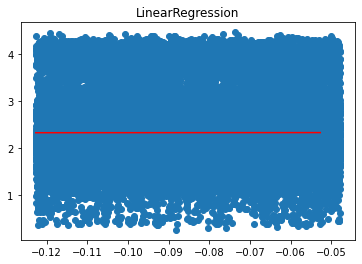

In [12]:
from catboost import CatBoostRegressor
from sklearn.linear_model import RANSACRegressor
from sklearn.linear_model import LinearRegression

# plot the dataset and the model's line of best fit
def plot_best_fit(X, y, model):
    # fut the model on all data
    model.fit(X, y)
    # plot the dataset
    plt.scatter(X, y)
    # plot the line of best fit
    xaxis = np.arange(X.min(), X.max(), 0.01)
    yaxis = model.predict(xaxis.reshape((len(xaxis), 1)))
    plt.plot(xaxis, yaxis, color='r')
    # show the plot
    plt.title(type(model).__name__)
    plt.show()
# define the model
model = LinearRegression()
#model = CatBoostRegressor(verbose = True)
df = df[df.mss_anomaly < -0.0478]
plot_df = df[df.mss_anomaly > -0.1227]
plot_best_fit(np.array(plot_df.mss_anomaly).reshape(-1, 1), plot_df.micro_mass, model)


In [13]:
plot_df = pd.DataFrame({'mss_anomaly' : plot_df.mss_anomaly, 'micro_mass' : plot_df.micro_mass})

fig = px.density_heatmap(plot_df, y="micro_mass", x="mss_anomaly", color_continuous_scale=px.colors.sequential.Blackbody)

fig.show()

In [7]:
df_wind_plot = pd.DataFrame({'nbrcs' : df.nbrcs, 'wind' : df.wind})
df_wind_plot = df_wind_plot[df_wind_plot.nbrcs > 12.5]
fig = px.density_heatmap(df_wind_plot, y="wind", x="nbrcs", color_continuous_scale=px.colors.sequential.Blackbody)

fig.show()